In [1]:
!pip -q install segmentation-models-pytorch

In [2]:
pip install --upgrade ipywidgets


Note: you may need to restart the kernel to use updated packages.


In [3]:
import torch
import torch.nn as nn
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import segmentation_models_pytorch as smp
from tqdm.notebook import tqdm

from torch.optim import *
from torch.utils.data import DataLoader, Dataset, sampler
from torchvision import datasets, transforms
import torchmetrics

import pytorch_lightning as pl

from PIL import Image
from glob import glob
import sys
import os
import skimage
import random
import gc

import wandb
import warnings
warnings.filterwarnings("ignore")

In [4]:
os.chdir("/kaggle/working")

In [5]:
class DiceLoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceLoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        intersection = (inputs * targets).sum()                            
        dice = (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        return 1 - dice

In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device


'cuda'

In [7]:
class LiTSDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)
        
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.images[idx])
        mask_name = img_name.replace("images", "masks")
        image = Image.open(img_name).resize((224, 224))
        mask = Image.open(mask_name).resize((224, 224))
        
        image = np.asarray(image)
        mask = np.asarray(mask)
        
        image = image / 255.
        image = np.expand_dims(image, axis=0)
        
        mask = (mask > 0).astype(np.uint8)
        mask = np.expand_dims(mask, axis=0)
            
        return torch.Tensor(image), torch.Tensor(mask).long()

In [8]:
dataset = LiTSDataset("/kaggle/input/litsdataset2/images", "/kaggle/input/litsdataset2/masks")

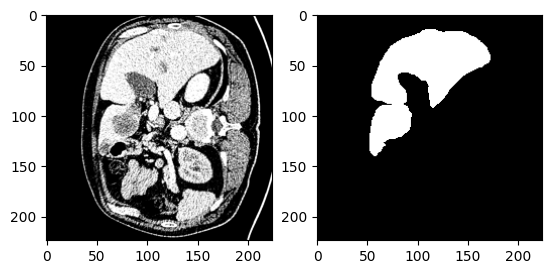

In [9]:
el, mask = random.choice(dataset)
plt.subplot(121)
plt.imshow(el[0], cmap='gray')

plt.subplot(122)
plt.imshow(mask[0], cmap='gray')

In [10]:
train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size
batch_size = 32

train_dataset, test_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, test_size, val_size])

In [11]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

In [12]:
class LitsModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        
        self.model = smp.UnetPlusPlus(
            encoder_name='efficientnet-b5',
            encoder_weights=None,
            in_channels=1,
            activation='sigmoid'
        )
        
        self.criterion = DiceLoss()
        
    def forward(self, x):
        return self.model(x)
        
    def training_step(self, batch):
        inputs, truth = batch
        outputs = self(inputs)
        
        loss = self.criterion(outputs, truth)
        self.log('loss/train', loss.item(), prog_bar=True)
        self.log('epoch/loss/train', loss.item(), prog_bar=True, on_epoch=True)
        
        return loss
    
    def test_step(self, batch):
        inputs, truth = batch
        outputs = self(inputs)
        
        loss = self.criterion(outputs, truth)
        self.log('loss/test', loss.item())
        self.log('dice', 1. - loss.item())
    
    def validation_step(self, batch):
        inputs, truth = batch
        outputs = self(inputs)
        
        loss = self.criterion(outputs, truth)
        self.log('loss/val', loss.item(), prog_bar=True)
        self.log('epoch/loss/val', loss.item(), prog_bar=True, on_epoch=True)
        
    def configure_optimizers(self):
        return RMSprop(self.parameters(), lr=1e-4)
    
    def prediction_step(self, batch, batch_idx, dataloader_idx=0):
        inputs, _ = batch
        return self(inputs)

In [13]:
gc.collect()
torch.cuda.empty_cache()

model = LitsModel()

In [20]:
trainer = pl.Trainer(
    max_epochs=10,
    max_time={'hours': 3},
#     limit_train_batches=250,
#     limit_val_batches=1,
#     limit_test_batches=1,
)

In [21]:
print("starting training ...")
trainer.fit(model, train_loader, val_loader)

starting training ...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [22]:
torch.save(model.state_dict(), "Unet++_efficientnet_liver_segmentation.pth")
print("Model saved successfully!")

Model saved successfully!


In [16]:
# model = LitsModel.load_from_checkpoint("/kaggle/input/litstrained/lightning_logs/version_0/checkpoints/epoch=4-step=7330.ckpt")

In [17]:
# trainer = pl.Trainer()

In [23]:
trainer.test(model, test_loader)

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           dice            │    0.9749401211738586     │
│         loss/test         │   0.025059495121240616    │
└───────────────────────────┴───────────────────────────┘

[{'loss/test': 0.025059495121240616, 'dice': 0.9749401211738586}]

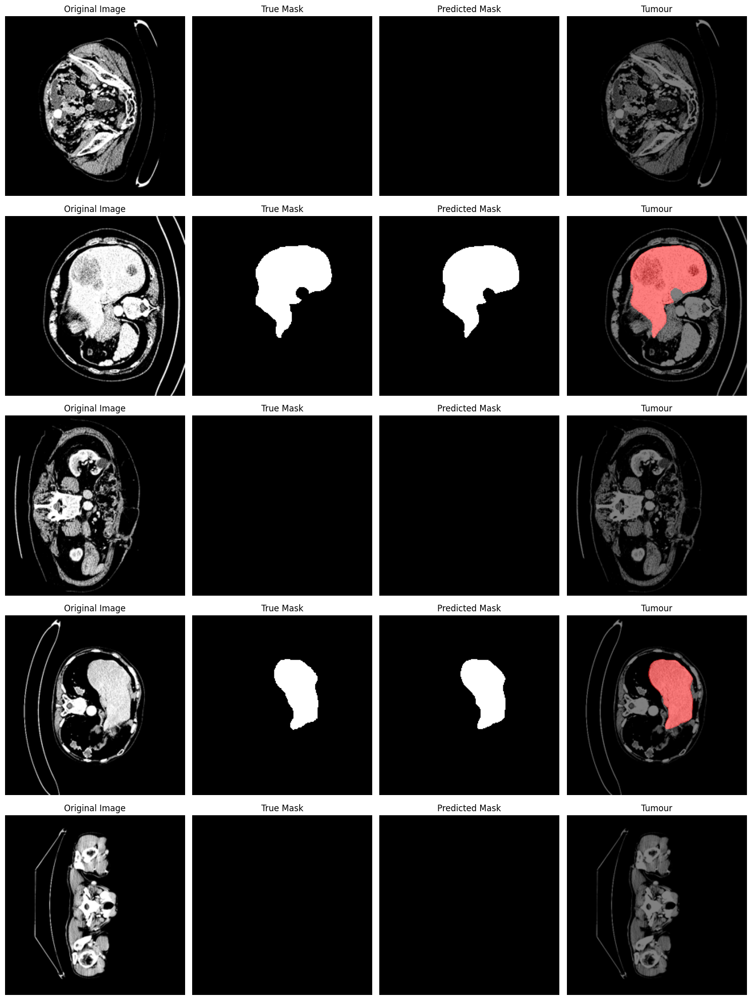

In [55]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import torch

def overlay_mask(image, mask, color=(255, 0, 0), alpha=0.5):
    """Overlay a mask on an image with a given color."""
    # Scale image to 0-255 range if needed
    if image.dtype == np.float32 or image.dtype == np.float64:
        image = (image * 255).astype(np.uint8)
    
    # Create a copy to avoid modifying the original
    image_copy = image.copy()
    
    # Ensure mask is binary (0 or 1)
    if mask.dtype != np.uint8:
        mask = (mask > 0).astype(np.uint8)
    
    # Debug print
    # print(f"Image shape: {image_copy.shape}, Mask shape: {mask.shape}")
    
    # Create a properly shaped colored mask
    mask_colored = np.zeros_like(image_copy)
    
    # Ensure mask is 2D regardless of input format
    if len(mask.shape) == 3 and mask.shape[2] == 1:
        mask_2d = mask[:, :, 0]
    else:
        mask_2d = mask
    
    # Apply the color channel by channel
    mask_colored[:, :, 0] = mask_2d * color[0]  # Red
    mask_colored[:, :, 1] = mask_2d * color[1]  # Green
    mask_colored[:, :, 2] = mask_2d * color[2]  # Blue
    
    # Overlay the colored mask on the image
    overlay = cv2.addWeighted(image_copy, 1 - alpha, mask_colored, alpha, 0)
    return overlay

def visualize_batch(model, dataloader, device):
    model.eval()  # Set model to evaluation mode
    
    # Get a batch of images and masks from the dataloader
    images, true_masks = next(iter(dataloader))
    images, true_masks = images.to(device), true_masks.to(device)
    
    # Get predictions from the model
    with torch.no_grad():
        pred_masks = model(images)
    
    # Convert tensors to numpy arrays
    images = images.cpu().numpy().transpose(0, 2, 3, 1)  # Convert from (B, C, H, W) to (B, H, W, C)
    
    # Handle grayscale images (B, 1, H, W) -> (B, H, W, 1)
    if images.shape[3] == 1:
        images = np.repeat(images, 3, axis=3)  # Convert to RGB by repeating the channel
    
    # Process masks
    true_masks = true_masks.cpu().numpy()
    pred_masks = pred_masks.cpu().numpy()
    
    # Ensure masks are 3D arrays (batch_size, height, width)
    if len(true_masks.shape) == 4 and true_masks.shape[1] == 1:  # (B, 1, H, W)
        true_masks = true_masks.squeeze(1)  # -> (B, H, W)
    
    if len(pred_masks.shape) == 4 and pred_masks.shape[1] == 1:  # (B, 1, H, W)
        pred_masks = pred_masks.squeeze(1)  # -> (B, H, W)
    
    # Apply threshold to predictions to make them binary
    pred_masks = (pred_masks > 0.5).astype(np.uint8)
    
    # Number of images to display
    num_images = min(5, len(images))  # Show up to 5 images
    
    # Create the figure and axes
    fig, axes = plt.subplots(num_images, 4, figsize=(15, num_images * 4))
    
    # Handle single image case
    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)
    
    for i in range(num_images):
        # Display original image
        axes[i, 0].imshow(images[i])
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis("off")
        
        # Display true mask
        axes[i, 1].imshow(true_masks[i], cmap="gray")
        axes[i, 1].set_title("True Mask")
        axes[i, 1].axis("off")
        
        # Display predicted mask
        axes[i, 2].imshow(pred_masks[i], cmap="gray")
        axes[i, 2].set_title("Predicted Mask")
        axes[i, 2].axis("off")
        
        # Create and display overlays
        overlay_pred = overlay_mask(images[i], pred_masks[i], color=(255, 0, 0))
        axes[i, 3].imshow(overlay_pred)
        axes[i, 3].set_title("Tumour")
        axes[i, 3].axis("off")
        

    
    plt.tight_layout()
    plt.show()

# Example usage:
visualize_batch(model, val_loader, device)

In [31]:
inputs = []
predictions = []
truths = []

device = 'cuda'
model = model.to(device)

with torch.no_grad():
    for input, truth in tqdm(test_loader):
        input, truth = input.to(device), truth.to(device)
        pred = model(input)
        
        inputs.append(input)
        predictions.append(pred)
        truths.append(truth)

  0%|          | 0/184 [00:00<?, ?it/s]

In [25]:
inputs2 = torch.cat(inputs).cpu().numpy().squeeze()
predictions2 = torch.cat(predictions).cpu().numpy().squeeze()
truths2 = torch.cat(truths).cpu().numpy().squeeze()

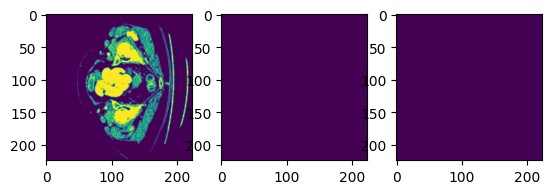

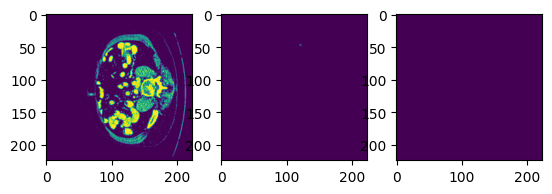

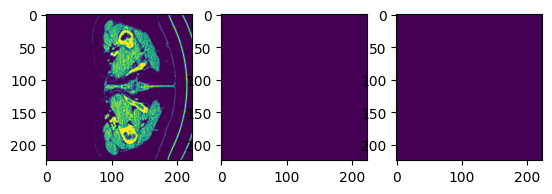

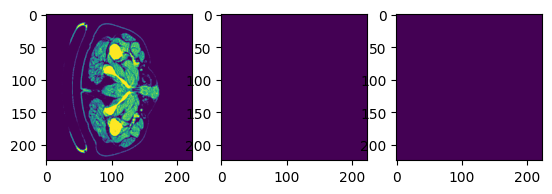

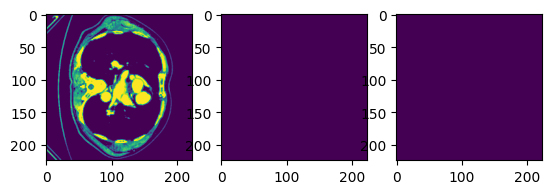

...

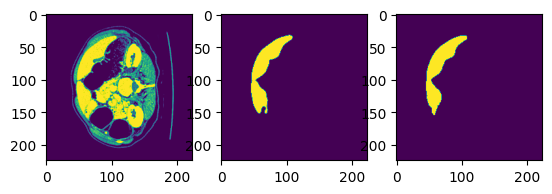

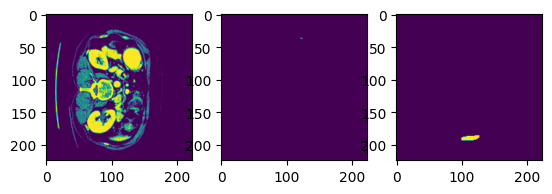

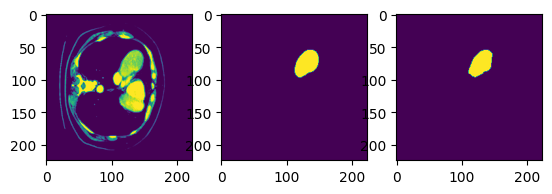

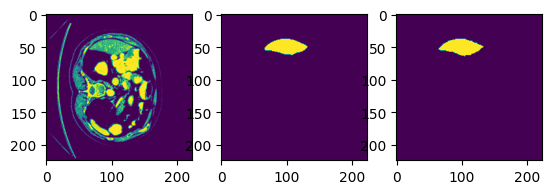

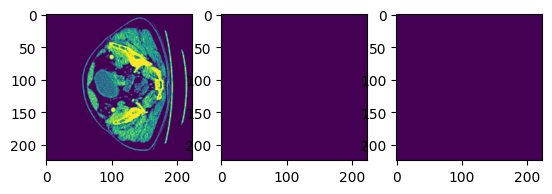

KeyboardInterrupt: 

In [26]:
for i, t, p in zip(inputs2, predictions2, truths2):
    plt.subplot(1,3,1)
    plt.imshow(i)
    
    plt.subplot(1,3,2)
    plt.imshow(t)
    
    plt.subplot(1,3,3)
    plt.imshow(p)
    plt.show()